#1. Import of libraries

In [1]:
import numpy as np
import urllib.parse
import pandas as pd
import requests
import os
import matplotlib.pyplot as plt
import math
import seaborn as sns 
from google.colab import drive
from  matplotlib.colors import LinearSegmentedColormap
from sklearn.cross_decomposition import PLSRegression
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error
drive.mount('drive')

Mounted at drive


#2. Import data

In [16]:
data=pd.read_csv('/content/drive/MyDrive/projet_2023/Dataset_complete.csv')
data=data.sort_values(by=['target', 'seqnum'])
data.head()
data=data.drop(['loc_initiator_z','ranging_unit','protocol','initiator','target', 'nlos_indicator','ranging_error', 'loc_target_z'], axis=1)

# 3. PLS regression with version 1

In [3]:
def score_distanceM(Xobserve:float, Yobserve:float, Xprevu:float, Yprevu:float) -> float:
    X=(Xobserve-Xprevu)**2
    Y=(Yobserve-Yprevu)**2
    return np.mean(np.sqrt(X+Y))

In [4]:
#Importation
train = pd.read_csv('/content/drive/MyDrive/projet_2023/train_v1.csv')
test = pd.read_csv('/content/drive/MyDrive/projet_2023/test_v1.csv')
validation = pd.read_csv('/content/drive/MyDrive/projet_2023/validation_v1.csv')

Y_train = train[['loc_initiator_x', 'loc_initiator_y']]
X_train = train.drop(["loc_initiator_x",'loc_initiator_y'], axis=1, inplace=False)

Y_test = test[['loc_initiator_x', 'loc_initiator_y']]
X_test = test.drop(["loc_initiator_x",'loc_initiator_y'], axis=1, inplace=False)

Y_val = validation[['loc_initiator_x', 'loc_initiator_y']]
X_val = validation.drop(["loc_initiator_x",'loc_initiator_y'], axis=1, inplace=False)

In [5]:
parameters = {'n_components':[3,6,9,12,20,30],
              'scale':[0,1,100,150,200],
              'max_iter' : [0,20,40,60,80,100,120,140,160,180,200,220,240,260,280,300,320,340,360,380,400,420,440,460,480,500]}
reg = PLSRegression()
clf = GridSearchCV(reg, parameters)
clf.fit(X_train, Y_train)
params_opti = clf.cv_results_['params'][clf.best_index_]
params_opti

/usr/local/lib/python3.8/dist-packages/sklearn/cross_decomposition/_pls.py:230: FutureWarning: As of version 0.24, n_components(30) should be in [1, n_features].n_components=20 will be used instead. In version 1.1 (renaming of 0.26), an error will be raised.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/cross_decomposition/_pls.py:230: FutureWarning: As of version 0.24, n_components(30) should be in [1, n_features].n_components=20 will be used instead. In version 1.1 (renaming of 0.26), an error will be raised.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/cross_decomposition/_pls.py:230: FutureWarning: As of version 0.24, n_components(30) should be in [1, n_features].n_components=20 will be used instead. In version 1.1 (renaming of 0.26), an error will be raised.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/cross_decomposition/_pls.py:230: FutureWarning: As of version 0.24, n_components(30) should be in [1, n_features].n_component

{'max_iter': 20, 'n_components': 20, 'scale': 1}

In [6]:
pls2 = PLSRegression(n_components = params_opti['n_components'], scale = params_opti['scale'], max_iter=params_opti['max_iter'] )
pls2 = reg.fit(X_train, Y_train)
y_pred_test=pls2.predict(X_test)
y_pred_val=pls2.predict(X_val)
score = pls2.score(X_train, Y_train)
print("Score:",score)

Score: 0.6478916471627318


In [7]:
print("mae test : ", mean_absolute_error(Y_test, y_pred_test))
print("rmse test : ", np.sqrt(mean_squared_error(Y_test,y_pred_test)))
print("mae validation : ", mean_absolute_error(Y_val, y_pred_val))
print("rmse validation : ", np.sqrt(mean_squared_error(Y_val,y_pred_val)))

mae test :  0.7092404951302462
rmse test :  0.9441894396019844
mae validation :  0.7296913512707951
rmse validation :  0.8822155275424005


In [8]:
score_distanceM(Xobserve = Y_test['loc_initiator_x'],
                Yobserve = Y_test['loc_initiator_y'],
                Xprevu = y_pred_test[:,0],
                Yprevu = y_pred_test[:,1])

1.0433088564232647

In [9]:
score_distanceM(Xobserve = Y_val['loc_initiator_x'],
                Yobserve = Y_val['loc_initiator_y'],
                Xprevu = y_pred_val[:,0],
                Yprevu = y_pred_val[:,1])

1.0733897095625042

#3. PLS regression with version 2

In [10]:
#Importation
train = pd.read_csv('/content/drive/MyDrive/projet_2023/train_v2.csv')
test = pd.read_csv('/content/drive/MyDrive/projet_2023/test_v2.csv')
validation = pd.read_csv('/content/drive/MyDrive/projet_2023/validation_v2.csv')

Y_train = train[['loc_initiator_x', 'loc_initiator_y']]
X_train = train.drop(["loc_initiator_x",'loc_initiator_y'], axis=1, inplace=False)

Y_test = test[['loc_initiator_x', 'loc_initiator_y']]
X_test = test.drop(["loc_initiator_x",'loc_initiator_y'], axis=1, inplace=False)

Y_val = validation[['loc_initiator_x', 'loc_initiator_y']]
X_val = validation.drop(["loc_initiator_x",'loc_initiator_y'], axis=1, inplace=False)

In [11]:
parameters = {'n_components':[3,6,9,12,20,30],
              'scale':[0,1,100,150,200],
              'max_iter' : [0,20,40,60,80,100,120,140,160,180,200,220,240,260,280,300,320,340,360,380,400,420,440,460,480,500]}
reg = PLSRegression()
clf = GridSearchCV(reg, parameters)
clf.fit(X_train, Y_train)
params_opti = clf.cv_results_['params'][clf.best_index_]
params_opti

/usr/local/lib/python3.8/dist-packages/sklearn/cross_decomposition/_pls.py:230: FutureWarning: As of version 0.24, n_components(30) should be in [1, n_features].n_components=25 will be used instead. In version 1.1 (renaming of 0.26), an error will be raised.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/cross_decomposition/_pls.py:230: FutureWarning: As of version 0.24, n_components(30) should be in [1, n_features].n_components=25 will be used instead. In version 1.1 (renaming of 0.26), an error will be raised.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/cross_decomposition/_pls.py:230: FutureWarning: As of version 0.24, n_components(30) should be in [1, n_features].n_components=25 will be used instead. In version 1.1 (renaming of 0.26), an error will be raised.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/cross_decomposition/_pls.py:230: FutureWarning: As of version 0.24, n_components(30) should be in [1, n_features].n_component

{'max_iter': 20, 'n_components': 20, 'scale': 1}

In [12]:
pls2 = PLSRegression(n_components = params_opti['n_components'], scale = params_opti['scale'], max_iter=params_opti['max_iter'] )
pls2 = reg.fit(X_train, Y_train)
y_pred_test=pls2.predict(X_test)
y_pred_val=pls2.predict(X_val)
score = pls2.score(X_train, Y_train)
print("Score:",score)

Score: 0.6206410973390024


#Score

In [13]:
print("mae test : ", mean_absolute_error(Y_test, y_pred_test))
print("rmse test : ", np.sqrt(mean_squared_error(Y_test,y_pred_test)))
print("mae validation : ", mean_absolute_error(Y_val, y_pred_val))
print("rmse validation : ", np.sqrt(mean_squared_error(Y_val,y_pred_val)))

mae test :  0.7197387308234955
rmse test :  0.9283858089923913
mae validation :  0.7471228301346895
rmse validation :  0.9040200108981806


In [14]:
score_distanceM(Xobserve = Y_test['loc_initiator_x'],
                Yobserve = Y_test['loc_initiator_y'],
                Xprevu = y_pred_test[:,0],
                Yprevu = y_pred_test[:,1])

1.058749246391738

In [15]:
score_distanceM(Xobserve = Y_val['loc_initiator_x'],
                Yobserve = Y_val['loc_initiator_y'],
                Xprevu = y_pred_val[:,0],
                Yprevu = y_pred_val[:,1])

1.0990330849632601

# Importation des CIR 

In [ ]:
df_CIR_183_101=pd.read_csv("/content/drive/MyDrive/projet_2023/CIR_183_101.csv")

df_CIR_183_150=pd.read_csv("/content/drive/MyDrive/projet_2023/CIR_183_150.csv")

df_CIR_183_171=pd.read_csv("/content/drive/MyDrive/projet_2023/CIR_183_171.csv")

df_CIR_183_180=pd.read_csv("/content/drive/MyDrive/projet_2023/CIR_183_180.csv")

df_CIR_183_184=pd.read_csv("/content/drive/MyDrive/projet_2023/CIR_183_184.csv")

In [ ]:
df_CIR_183_101

,initiator,target,protocol,nlos_indicator,t1,t2,t3,t4,skew,tof,...,modulus_comp_195,modulus_abs_195,modulus_comp_196,modulus_abs_196,modulus_comp_197,modulus_abs_197,modulus_comp_198,modulus_abs_198,modulus_comp_199,modulus_abs_199
0,183,101,TWR,20.052750,958585021070,958973595867,959077448334,958688875846,-1.107493,1154,...,(-24+1j),24.020824,(-74+11j),74.813100,(-6+12j),13.416408,(9+25j),26.570661,(32+33j),45.967380
1,183,101,TWR,18.801702,1021861150862,1022249829124,1022353090702,1021964414740,-1.907349,1150,...,(18-12j),21.633308,(-5-28j),28.442925,(-21-30j),36.619667,(-13-26j),29.068884,(36-55j),65.734314
2,183,101,TWR,19.264353,1085306097806,1085694879388,1085798285966,1085409506691,-2.276513,1153,...,(45+22j),50.089919,(48-22j),52.801515,(21-18j),27.658633,(-13-43j),44.922155,(-51-43j),66.708320
3,183,101,TWR,18.024691,49069009550,49457893830,49560945806,49172063842,-1.384366,1158,...,(-36+3j),36.124784,(-27+4j),27.294688,(-38-28j),47.201695,9j,9.000000,(14+48j),50.000000
4,183,101,TWR,21.375772,112287082126,112676068701,112779380878,112390396613,-2.184222,1155,...,(6+15j),16.155494,(35+15j),38.078866,(62+17j),64.288413,(40+5j),40.311289,(17+5j),17.720045
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
701,183,101,TWR,3.011880,350701621902,351219630882,351323385998,350805378924,-2.153458,953,...,(-19-1j),19.026298,(-24+3j),24.186773,(-40+2j),40.049969,(-50-2j),50.039984,(-13-5j),13.928388
702,183,101,TWR,3.397784,424635705486,425153876958,425256490126,424738320561,-1.753530,953,...,(-2-29j),29.068884,(19-35j),39.824616,(6-31j),31.575307,(14-27j),30.413813,(14-25j),28.653098
703,183,101,TWR,2.496211,498609368718,499127702604,499230964878,498712632908,-1.722767,958,...,(-70+60j),92.195445,(-78+79j),111.018017,(-76+69j),102.649890,(-12+13j),17.691806,17j,17.000000
704,183,101,TWR,2.395657,572598296206,573116792513,573219775630,572701281240,-2.091931,958,...,(-2+13j),13.152946,(30+33j),44.598206,(41+7j),41.593269,(34+12j),36.055513,(21-4j),21.377558


<ipython-input-6-55f34e76e000>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(i)
<ipython-input-6-55f34e76e000>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(i)
<ipython-input-6-55f34e76e000>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(i)
<ipython-input-6-55f34e76e000>:2: RuntimeWa

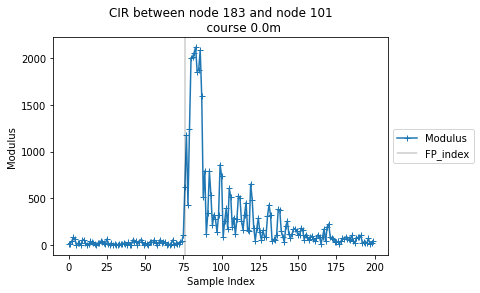

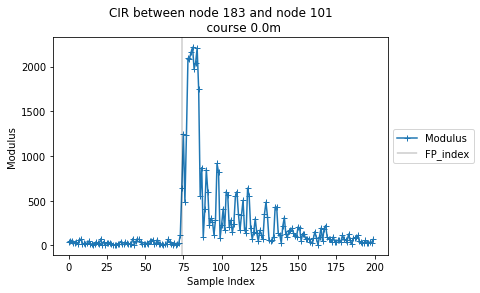

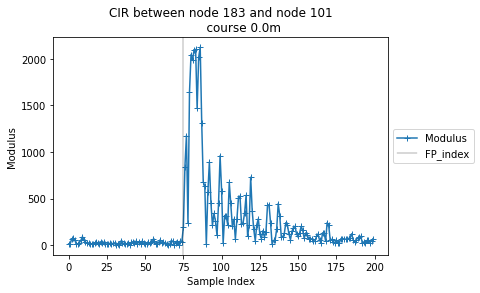

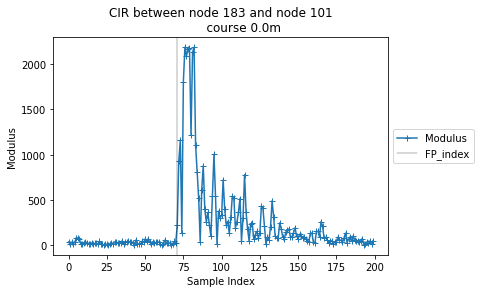

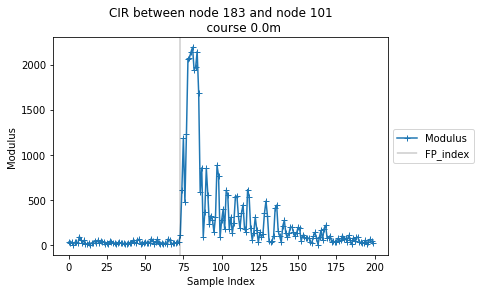

...

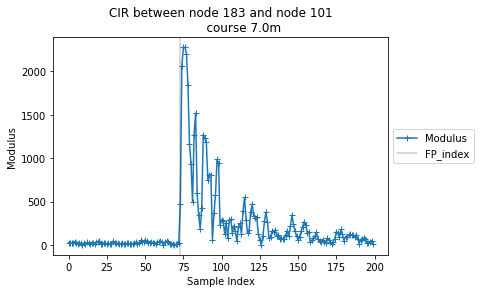

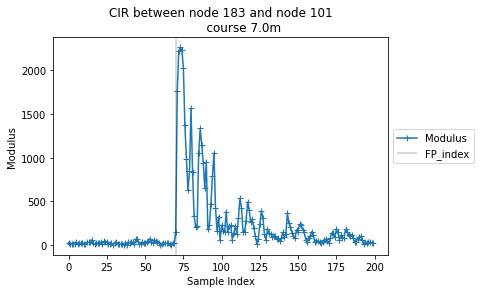

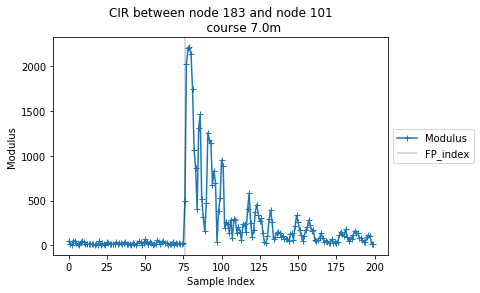

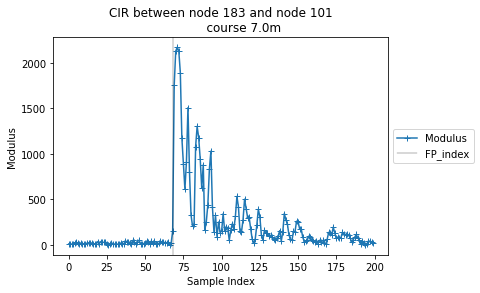

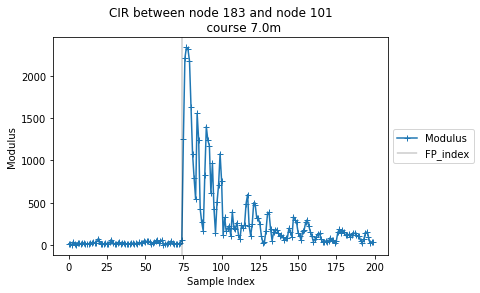

In [ ]:
for i in range(df_CIR_183_101.shape[0]) :
  plt.figure(i)
  columns = [f'modulus_abs_{str(i).zfill(3)}' for i in range(200)]
  plt.plot(
      np.array(df_CIR_183_101[columns].iloc[i]),
      '+-',
      label='Modulus'
  )
  plt.axvline(df_CIR_183_101.iloc[i].FP_index, color='k', linewidth=0.3, label='FP_index')
  plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
  plt.title(f"""CIR between node {df_CIR_183_101.iloc[i].initiator} and node {df_CIR_183_101.iloc[i].target}
            course {np.round(df_CIR_183_101.iloc[i].course_dist, 2)}{df_CIR_183_101.iloc[i].ranging_unit}""")
  plt.xlabel('Sample Index')
  plt.ylabel('Modulus')